# Data Visulisations and Analysis of Cleaned Data
## Dataframe Processing
This workbook analyses the cleaned dataset prior to being run through sentiment analysis. Once run it will provide information of the frequencies and trends in Users, Words (Tokens) and Securities and their individual relationships to being labelled as Bullish or Bearish. 

In [83]:
# Import Dataframe and Processing Libraries
import pandas as pd
from collections import Counter

# Import Data Visulisation Libraries
import matplotlib.pyplot as plt
import numpy as np
from wordcloud import WordCloud

plt.style.use('ggplot')

# set jupyter's max row display
pd.set_option('display.max_row', 1000)

# set jupyter's max column width to 50
pd.set_option('display.max_columns', 50)

In [84]:
# Read and import the relative csv as dataframe
data = pd.read_csv("../12-cleaning-raw-dataset/datasets/cleanedData.csv")
data.head()

,user,message_id,sentiment,content,date,time,securities,tweet text,tokens,num_of_tokens,tokens_in_transformed_text,num_of_tokens_in_transformed_text
0,babybounce,/babybounce/message/226382374,Bullish,$BA travel going green bullish $CCL $RCL $NCLH...,09/07/2020,12:21:03,"['BA', 'CCL', 'RCL', 'NCLH']",travel going green bullish,"['travel', 'going', 'green', 'bullish']",4,"['travel', 'go', 'green', 'bullish']",4
1,L1_Trading,/L1_Trading/message/226381562,Bullish,$SPY let’s go mooning today,09/07/2020,12:21:03,[],let’s go mooning today,"['let', 'go', 'mooning', 'today']",4,"['let', 'go', 'moon', 'today']",4
2,Economist4401,/Economist4401/message/226381511,Bearish,$SPY $SPX $DJIA $DIA $QQQ Analysts on US stock...,09/07/2020,12:21:03,"['SPX', 'DJIA', 'DIA', 'QQQ']","Analysts on US stock markets: 1. On Monday, Bl...","['analysts', 'us', 'stock', 'markets', 'monday...",59,"['analyst', 'us', 'stock', 'market', 'monday',...",38
3,OkieOkie,/OkieOkie/message/226381256,Bearish,$SPY more China. China wants some of Australia...,09/07/2020,12:21:03,[],more China. China wants some of Australia lol🦘🦘🦘🦘,"['china', 'china', 'wants', 'australia', 'lol']",8,"['china', 'china', 'want', 'australia', 'lol']",5
4,risksavage_inthemarket,/risksavage_inthemarket/message/226381105,Bullish,$GNLN $CGC $SPY $KERN $PM “What Does The Insti...,09/07/2020,12:21:03,"['GNLN', 'CGC', 'KERN', 'PM']",“What Does The Institutional Ownership Tell Us...,"['institutional', 'ownership', 'tell', 'us', '...",80,"['institutional', 'ownership', 'tell', 'us', '...",45


In [85]:
# Create two boolean tables for bullish and bearish
bullish_tweet_class =  data['sentiment']=='Bullish'
bearish_tweet_class =  data['sentiment']=='Bearish'

In [86]:
# Create two seperate tables for bullish and bearish data
bullish_data = data[bullish_tweet_class]
bearish_data = data[bearish_tweet_class]

bearish_data.head()

,user,message_id,sentiment,content,date,time,securities,tweet text,tokens,num_of_tokens,tokens_in_transformed_text,num_of_tokens_in_transformed_text
2,Economist4401,/Economist4401/message/226381511,Bearish,$SPY $SPX $DJIA $DIA $QQQ Analysts on US stock...,09/07/2020,12:21:03,"['SPX', 'DJIA', 'DIA', 'QQQ']","Analysts on US stock markets: 1. On Monday, Bl...","['analysts', 'us', 'stock', 'markets', 'monday...",59,"['analyst', 'us', 'stock', 'market', 'monday',...",38
3,OkieOkie,/OkieOkie/message/226381256,Bearish,$SPY more China. China wants some of Australia...,09/07/2020,12:21:03,[],more China. China wants some of Australia lol🦘🦘🦘🦘,"['china', 'china', 'wants', 'australia', 'lol']",8,"['china', 'china', 'want', 'australia', 'lol']",5
7,DannETrader,/DannETrader/message/226380472,Bearish,$SPY yesterday was last day of FED repo’s. It ...,09/07/2020,12:21:03,[],yesterday was last day of FED repo’s. It isn’t...,"['yesterday', 'last', 'day', 'fed', 'repo', 'i...",12,"['yesterday', 'last', 'day', 'feed', 'repo', '...",8
12,risksavage_inthemarket,/risksavage_inthemarket/message/226382588,Bearish,$SPY $TSLA $BA $JPM $ZM GRAB A NOTEPAD!!! \r\n...,09/07/2020,12:21:34,"['TSLA', 'BA', 'JPM', 'ZM']",GRAB A NOTEPAD!!! Investing101 FB@risksavagema...,"['grab', 'notepad', 'investing101', 'fb', 'wat...",9,"['grab', 'notepad', 'investing101', 'fb', 'wat...",9
15,ihavespoken,/ihavespoken/message/226383179,Bearish,$SPY 900 point drop in crude coming,09/07/2020,12:25:38,[],900 point drop in crude coming,"['point', 'drop', 'crude', 'coming']",5,"['point', 'drop', 'crude', 'come']",4


### Proportion of bullish and bearish tweets

In [87]:
print("Total amount of tweets: ", len(data), " \nTotal amount of bullish tweets: ", len(bullish_data), " \nTotal amount of bearish tweets: ", len(bearish_data))

Total amount of tweets:  37476  
Total amount of bullish tweets:  22438  
Total amount of bearish tweets:  15038


# User Analysis and Visulisations
## Dataframe Processing

In [88]:
# Group and Count the amount of tweets for bullish and bearish users
bearish_user_count = Counter(bearish_data['user'])
bullish_user_count = Counter(bullish_data['user'])

In [89]:
# Convert lists into dataframes
df_bullish_users = pd.DataFrame(bullish_user_count.items(), columns=["User", "Bullish Occurences"])
df_bearish_users = pd.DataFrame(bearish_user_count.items(), columns=["User", "Bearish Occurences"])

df_bearish_users.head(3)

,User,Bearish Occurences
0,Economist4401,305
1,OkieOkie,88
2,DannETrader,11


In [90]:
# Join the tables
user_results = df_bullish_users.merge(df_bearish_users, how= 'outer', on= 'User')
user_results['Bullish Occurences'].fillna(0, inplace=True)
user_results['Bearish Occurences'].fillna(0, inplace=True)

user_results.head(3)

,User,Bullish Occurences,Bearish Occurences
0,babybounce,3.0,0.0
1,L1_Trading,52.0,12.0
2,risksavage_inthemarket,44.0,112.0


In [91]:
# Add total column
total_column = user_results['Bullish Occurences'] + user_results['Bearish Occurences']
user_results['Total'] = total_column

user_results.head(3)

,User,Bullish Occurences,Bearish Occurences,Total
0,babybounce,3.0,0.0,3.0
1,L1_Trading,52.0,12.0,64.0
2,risksavage_inthemarket,44.0,112.0,156.0


In [92]:
# Creating Percentage Bullish to Bearish Columns
bullish_percentages = (user_results['Bullish Occurences'] / user_results['Total'])
bearish_percentages = (user_results['Bearish Occurences'] / user_results['Total'])

user_results.insert(2, "Bullish Percentages", bullish_percentages)
user_results.insert(4, "Bearish Percentages", bearish_percentages)

### Final User Table
Below shows the user and the amount of bullish, bearish and total tweets they've made as well as their respective percentages calculated as decimals. For users where they have more than 20 tweets total and more than either 80% bullish or 80% bearish tweets a new column has been made as these users may automatically be labelled as Bullish or Bearish Prior to sentiment analysis. Any user labelled as 'Unpredictable' will put through the machine learning model as this is belived to increase accuracy of the analyser.

In [93]:
# Filter and Lable Users
user_results.loc[(user_results['Total'] < 20), 'Naive Sentiment Prediction'] = 'Unpredictable'
user_results.loc[(user_results['Total'] >= 20) & (user_results['Bullish Percentages'] <= 0.8) & (user_results['Bullish Percentages'] >= 0.2), 'Naive Sentiment Prediction'] = 'Unpredictable'

user_results.loc[(user_results['Total'] >= 20) & (user_results['Bullish Percentages'] >= 0.8), 'Naive Sentiment Prediction'] = 'Bullish'
user_results.loc[(user_results['Total'] >= 20) & (user_results['Bullish Percentages'] <= 0.2), 'Naive Sentiment Prediction'] = 'Bearish'
user_results.head()

,User,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
0,babybounce,3.0,1.000000,0.0,0.000000,3.0,Unpredictable
1,L1_Trading,52.0,0.812500,12.0,0.187500,64.0,Bullish
2,risksavage_inthemarket,44.0,0.282051,112.0,0.717949,156.0,Unpredictable
3,HeyYouWhoMe,306.0,1.000000,0.0,0.000000,306.0,Bullish
4,KaroleinTriedToTrade,6.0,1.000000,0.0,0.000000,6.0,Unpredictable


Below shows the amount of users which can be automatically categorised. This helps show the proportion of the final dataset which may be positivley impacted by this addition of featured engineering.

In [94]:
# Grouped Predictable User Sentiments
grouped_predictions =  user_results.groupby(['Naive Sentiment Prediction']).sum()
grouped_predictions = grouped_predictions.drop(columns = ['Bullish Percentages', 'Bearish Percentages'], axis = 1)
grouped_predictions

,Bullish Occurences,Bearish Occurences,Total
Naive Sentiment Prediction,,,
Bearish,334.0,6707.0,7041.0
Bullish,10224.0,270.0,10494.0
Unpredictable,11880.0,8061.0,19941.0


In [95]:
# Sort by total column and find top 10
user_results = user_results.sort_values(by='Total', ascending = False)
bar_user_results = user_results.head(15)

bar_user_results

,User,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
4383,MarsProbe,0.0,0.000000,515.0,1.000000,515.0,Bearish
183,OhYesNotMe,375.0,0.968992,12.0,0.031008,387.0,Bullish
2780,VTGuy,274.0,0.817910,61.0,0.182090,335.0,Bullish
1575,Economist4401,5.0,0.016129,305.0,0.983871,310.0,Bearish
3,HeyYouWhoMe,306.0,1.000000,0.0,0.000000,306.0,Bullish
164,DefStar,302.0,1.000000,0.0,0.000000,302.0,Bullish
6,Burrrr_time,247.0,0.995968,1.0,0.004032,248.0,Bullish
1469,InvestorShock,31.0,0.133621,201.0,0.866379,232.0,Bearish
915,SeriouslyFurious,218.0,1.000000,0.0,0.000000,218.0,Bullish
184,babyPluto,215.0,1.000000,0.0,0.000000,215.0,Bullish


### Final Tables with predictable and unpredictable users

In [96]:
#filtering tweets for 20 + tweets by User and over 80% lean towards bullish or Bearish
predictable_user_boo = user_results['Naive Sentiment Prediction'] != 'Unpredictable'
predictable_user = user_results[predictable_user_boo]
predictable_user.head()

,User,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
4383,MarsProbe,0.0,0.000000,515.0,1.000000,515.0,Bearish
183,OhYesNotMe,375.0,0.968992,12.0,0.031008,387.0,Bullish
2780,VTGuy,274.0,0.817910,61.0,0.182090,335.0,Bullish
1575,Economist4401,5.0,0.016129,305.0,0.983871,310.0,Bearish
3,HeyYouWhoMe,306.0,1.000000,0.0,0.000000,306.0,Bullish


In [97]:
#filtering tweets for 20 + tweets by User and over 80% lean towards bullish or Bearish
unpredictable_user_boo = user_results['Naive Sentiment Prediction'] == 'Unpredictable'
unpredictable_user = user_results[unpredictable_user_boo]
unpredictable_user.head()

,User,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
350,v3tuz,68.0,0.343434,130.0,0.656566,198.0,Unpredictable
3282,la_pulga,89.0,0.489011,93.0,0.510989,182.0,Unpredictable
600,BULLiSH_Y0DA_NUTS,139.0,0.785311,38.0,0.214689,177.0,Unpredictable
204,RealTimeTradingIdeas,77.0,0.461078,90.0,0.538922,167.0,Unpredictable
2,risksavage_inthemarket,44.0,0.282051,112.0,0.717949,156.0,Unpredictable


In [98]:
# Export Table to Excel (If needed)
user_results.to_csv(r"./userCount.csv", index = True)

## User Data Visulisations

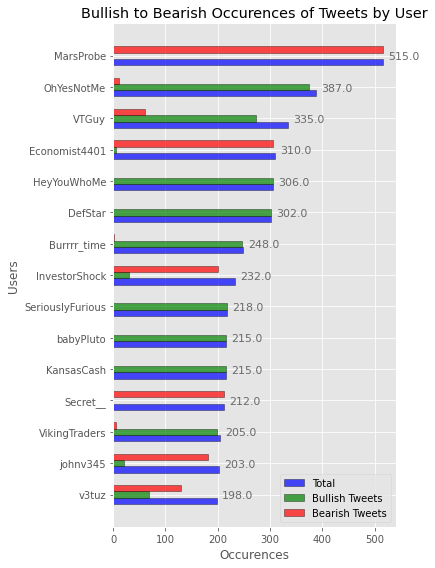

In [99]:
# Create Bar Chart of user and occurences
y_user = bar_user_results['User'].tolist()
y_user.reverse()

y_user_indexes = np.arange(len(y_user))
height = 0.2

x_user_bull = bar_user_results['Bullish Occurences'].tolist()
x_user_bear = bar_user_results['Bearish Occurences'].tolist()
x_user_total = bar_user_results['Total'].tolist()

x_user_bull.reverse()
x_user_bear.reverse()
x_user_total.reverse()

plt.figure(figsize=(6,8))

multi = plt.subplot()
rects1 = multi.barh(y_user_indexes - height, x_user_total, height = height, edgecolor='black',  color = 'blue', alpha = 0.7, label = 'Total')
rects2 = multi.barh(y_user_indexes, x_user_bull, height = height, edgecolor='black', color = 'green', alpha = 0.7, label = 'Bullish Tweets')
rects3 = multi.barh(y_user_indexes + height, x_user_bear, height = height, edgecolor='black' , color = 'red', alpha = 0.7, label = 'Bearish Tweets')

plt.xlabel('Occurences')
plt.ylabel('Users')
plt.yticks(ticks = y_user_indexes, labels = y_user)
plt.title('Bullish to Bearish Occurences of Tweets by User')

# set individual bar lables using above list
for i in rects1:
    # get_width pulls left or right; get_y pushes up or down
    plt.text(i.get_width() + 10, i.get_y() + .18, \
            str(round((i.get_width()), 2)), fontsize=11, color='dimgrey')

plt.legend()
plt.tight_layout()
plt.show()

above shows the users with the greatest amount of tweets and the proportion of their tweets which are Bullish or Bearish. This show the benefit to automatically predicting some users as they will have greater than an 80% accuracy for correct predictions.

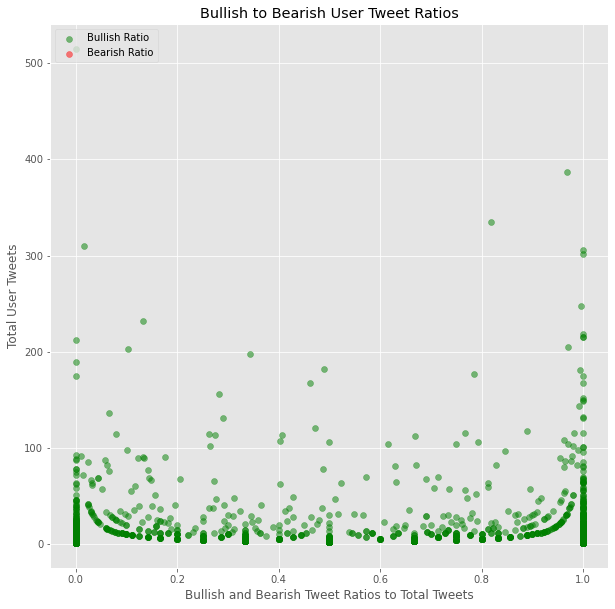

In [100]:
# Plot the Scatter Graph
x_bull = user_results['Bullish Percentages'].tolist()
x_bear = (user_results['Bearish Percentages']*-1).tolist()
y_user_tweets = user_results['Total'].tolist()

plt.figure(figsize=(10,10))

plt.title('Bullish to Bearish User Tweet Ratios')
plt.xlabel('Bullish and Bearish Tweet Ratios to Total Tweets')
plt.ylabel('Total User Tweets')

bull = plt.scatter(x_bull, y_user_tweets, alpha = 0.5, c='g')
# Uncomment the line below to see the bullish ratio of tweets to total tweets but as both bullish and bearish are based off of the total tweets the data is the same but inversed.
#bear = plt.scatter(x_bear, y_user_tweets, alpha = 0.5, c='r')

plt.legend((bull, bear), ('Bullish Ratio', 'Bearish Ratio'), loc='upper left', fontsize=10)

plt.show()

Above shows the ratio of Bullish tweets to the total amount of tweets. There are accumulations of tweets along the bottom axis as when a user tweets two time then the value must show either bullish, bearish or in the center of the graph. Due to this as the number of tweets increase so does the amount of these small clusters along the bottom axis. There are also asymptotes towards the 0 and 1 as to have a 0.99 percent bullish ratio the user would have to tweet atleast 100 times hence why there must be the gaps there.

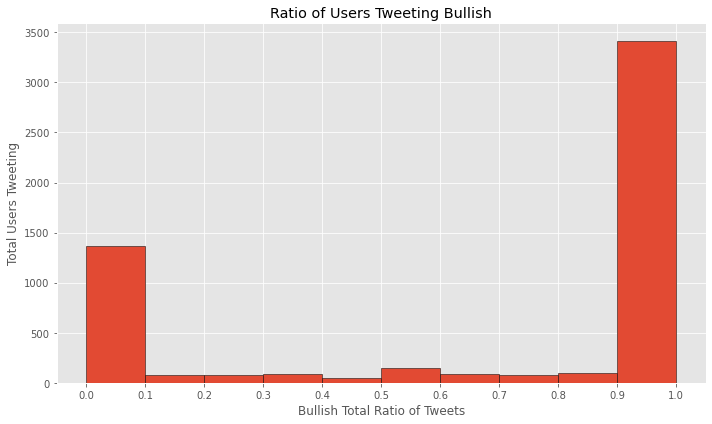

In [101]:
# Histogram for ratio's of Bullish to Total Tweets
x_ratios = user_results['Bullish Percentages'].tolist()
bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

plt.figure(figsize = (10,6))

plt.hist(x_ratios, bins = bins, edgecolor = 'black')

plt.title('Ratio of Users Tweeting Bullish')
plt.xlabel('Bullish Total Ratio of Tweets')
plt.ylabel('Total Users Tweeting')
plt.xticks(ticks = bins)

plt.tight_layout()

plt.show()

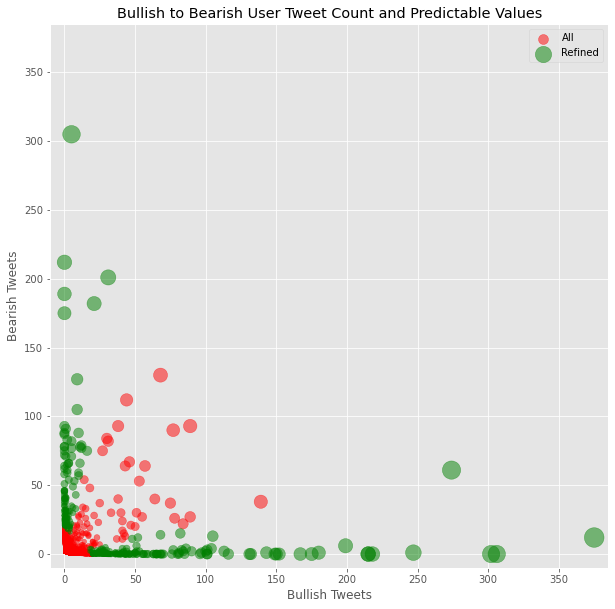

In [102]:
#predictable_user = predictable_user.sort_values(by='Total', ascending= False)
x_bull = unpredictable_user['Bullish Occurences'].tolist()
y_bear = unpredictable_user['Bearish Occurences'].tolist()
s_total = unpredictable_user['Total'].tolist()

x_bull_ref = predictable_user['Bullish Occurences'].tolist()
y_bear_ref = predictable_user['Bearish Occurences'].tolist()
s_total_ref = predictable_user['Total'].tolist()

plt.figure(figsize=(10,10))

#ax1 = plt.add_subplot(111)
plt.scatter(x_bull, y_bear, s = s_total, alpha = 0.5, c = 'r', label = 'All')
plt.scatter(x_bull_ref, y_bear_ref, s = s_total_ref, alpha = 0.5, c = 'g', label = 'Refined')

plt.legend(loc='upper right')
plt.title('Bullish to Bearish User Tweet Count and Predictable Values')
plt.xlabel('Bullish Tweets')
plt.ylabel('Bearish Tweets')

# Find maximum plot value of bullish or bearish tweets
if max(x_bull) >= max(y_bear):
    plt.xlim(-10, max(x_bull and x_bull_ref) + 10)
    plt.ylim(-10, max(x_bull and x_bull_ref) + 10)
else:
    plt.xlim(-10, max(y_bear and y_bear_ref) + 10)
    plt.ylim(-10, max(y_bear and y_bear_ref) + 10)

plt.show()

The area of this graph show the possible increase in accuracy relative to securities and tokens.

# Token Analysis and Validation
## Token Dataframe Processing

In [103]:
# count occurences of words of value
bullish_words = [word for tweet in bullish_data['tokens_in_transformed_text'] for word in tweet.replace(",", "").replace("[", "").replace("]", "").replace("'", "").split(' ')]
bullish_word_count = Counter(bullish_words)

bearish_words = [word for tweet in bearish_data['tokens_in_transformed_text'] for word in tweet.replace(",", "").replace("[", "").replace("]", "").replace("'", "").split(' ')]
bearish_word_count = Counter(bearish_words)

In [104]:
# Convert lists into dataframes
df_bullish = pd.DataFrame(bullish_word_count.items(), columns=["Word", "Bullish Occurences"])

df_bearish = pd.DataFrame(bearish_word_count.items(), columns=["Word", "Bearish Occurences"])
df_bearish.head()

,Word,Bearish Occurences
0,analyst,43
1,us,425
2,stock,831
3,market,1954
4,monday,270


In [105]:
# Join the tables
token_results = df_bullish.merge(df_bearish, how= 'outer', on= 'Word')
token_results['Bullish Occurences'].fillna(0, inplace=True)
token_results['Bearish Occurences'].fillna(0, inplace=True)
token_results.head()

,Word,Bullish Occurences,Bearish Occurences
0,travel,49.0,23.0
1,go,2706.0,1971.0
2,green,816.0,287.0
3,bullish,775.0,232.0
4,let,830.0,453.0


In [106]:
# Add total column
total_column = token_results['Bullish Occurences'] + token_results['Bearish Occurences']
token_results['Total'] = total_column
token_results

,Word,Bullish Occurences,Bearish Occurences,Total
0,travel,49.0,23.0,72.0
1,go,2706.0,1971.0,4677.0
2,green,816.0,287.0,1103.0
3,bullish,775.0,232.0,1007.0
4,let,830.0,453.0,1283.0
...,...,...,...,...
19009,reinstall,0.0,1.0,1.0
19010,corey,0.0,1.0,1.0
19011,booker,0.0,1.0,1.0
19012,yuuuuuuuuge,0.0,1.0,1.0


In [107]:
# Creating Percentage Bullish to Bearish Columns
bullish_percentages = (token_results['Bullish Occurences'] / token_results['Total'])
bearish_percentages = (token_results['Bearish Occurences'] / token_results['Total'])

token_results.insert(2, "Bullish Percentages", bullish_percentages)
token_results.insert(4, "Bearish Percentages", bearish_percentages)

In [108]:
# Sort by total column and find top 15
token_results = token_results.sort_values(by='Total', ascending= False)
token_results.head()

,Word,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total
1,go,2706.0,0.578576,1971.0,0.421424,4677.0
45,get,2176.0,0.569932,1642.0,0.430068,3818.0
20,market,1847.0,0.485925,1954.0,0.514075,3801.0
52,bear,2991.0,0.857266,498.0,0.142734,3489.0
111,buy,2016.0,0.678559,955.0,0.321441,2971.0


In [109]:
# Filter and Lable Users
token_results.loc[(token_results['Total'] < 20), 'Naive Sentiment Prediction'] = 'Unpredictable'
token_results.loc[(token_results['Total'] >= 20) & (token_results['Bullish Percentages'] <= 0.8) & (token_results['Bullish Percentages'] >= 0.2), 'Naive Sentiment Prediction'] = 'Unpredictable'

token_results.loc[(token_results['Total'] >= 20) & (token_results['Bullish Percentages'] >= 0.8), 'Naive Sentiment Prediction'] = 'Bullish'
token_results.loc[(token_results['Total'] >= 20) & (token_results['Bullish Percentages'] <= 0.2), 'Naive Sentiment Prediction'] = 'Bearish'
token_results.head()

,Word,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
1,go,2706.0,0.578576,1971.0,0.421424,4677.0,Unpredictable
45,get,2176.0,0.569932,1642.0,0.430068,3818.0,Unpredictable
20,market,1847.0,0.485925,1954.0,0.514075,3801.0,Unpredictable
52,bear,2991.0,0.857266,498.0,0.142734,3489.0,Bullish
111,buy,2016.0,0.678559,955.0,0.321441,2971.0,Unpredictable


In [110]:
# Grouped Predictable User Sentiments
grouped_predictions =  token_results.groupby(['Naive Sentiment Prediction']).sum()
grouped_predictions = grouped_predictions.drop(columns = ['Bullish Percentages', 'Bearish Percentages'], axis = 1)
grouped_predictions

,Bullish Occurences,Bearish Occurences,Total
Naive Sentiment Prediction,,,
Bearish,290.0,1659.0,1949.0
Bullish,18807.0,1917.0,20724.0
Unpredictable,187921.0,146065.0,333986.0


In [111]:
# Sort by total column and find top 10
token_results = token_results.sort_values(by='Total', ascending = False)
bar_token_results = token_results.head(15)

bar_token_results

,Word,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
1,go,2706.0,0.578576,1971.0,0.421424,4677.0,Unpredictable
45,get,2176.0,0.569932,1642.0,0.430068,3818.0,Unpredictable
20,market,1847.0,0.485925,1954.0,0.514075,3801.0,Unpredictable
52,bear,2991.0,0.857266,498.0,0.142734,3489.0,Bullish
111,buy,2016.0,0.678559,955.0,0.321441,2971.0,Unpredictable
73,com,2053.0,0.746274,698.0,0.253726,2751.0,Unpredictable
59,day,1733.0,0.655446,911.0,0.344554,2644.0,Unpredictable
82,not,1130.0,0.469854,1275.0,0.530146,2405.0,Unpredictable
32,stock,1393.0,0.626349,831.0,0.373651,2224.0,Unpredictable
37,like,1244.0,0.562641,967.0,0.437359,2211.0,Unpredictable


In [112]:
#filtering tweets for 20 + tweets by User and over 80% lean towards bullish or Bearish
predictable_token_boo = token_results['Naive Sentiment Prediction'] != 'Unpredictable'
predictable_token = token_results[predictable_token_boo]
predictable_token.head()

,Word,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
52,bear,2991.0,0.857266,498.0,0.142734,3489.0,Bullish
63,trading,831.0,0.859359,136.0,0.140641,967.0,Bullish
74,invite,882.0,0.995485,4.0,0.004515,886.0,Bullish
72,discord,863.0,0.995386,4.0,0.004614,867.0,Bullish
71,option,643.0,0.872456,94.0,0.127544,737.0,Bullish


In [113]:
#filtering tweets for 20 + tweets by User and over 80% lean towards bullish or Bearish
unpredictable_token_boo = token_results['Naive Sentiment Prediction'] == 'Unpredictable'
unpredictable_token = token_results[unpredictable_token_boo]
unpredictable_token.head()

,Word,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
1,go,2706.0,0.578576,1971.0,0.421424,4677.0,Unpredictable
45,get,2176.0,0.569932,1642.0,0.430068,3818.0,Unpredictable
20,market,1847.0,0.485925,1954.0,0.514075,3801.0,Unpredictable
111,buy,2016.0,0.678559,955.0,0.321441,2971.0,Unpredictable
73,com,2053.0,0.746274,698.0,0.253726,2751.0,Unpredictable


In [114]:
# Export Table to Excel (If needed)
token_results.to_csv(r"./wordCount.csv", index = True)

## Token Data Visulisations

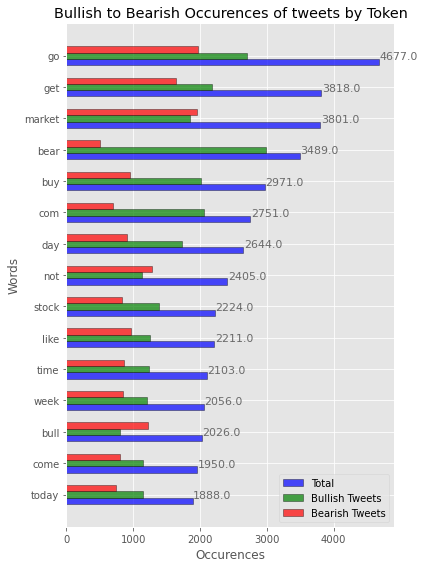

In [115]:
# Create Bar Chart of user and occurences
y_token_word = bar_token_results['Word'].tolist()
y_token_word.reverse()

y_token_indexes = np.arange(len(y_token_word))
height = 0.2

x_token_bull = bar_token_results['Bullish Occurences'].tolist()
x_token_bear = bar_token_results['Bearish Occurences'].tolist()
x_token_total = bar_token_results['Total'].tolist()

x_token_bull.reverse()
x_token_bear.reverse()
x_token_total.reverse()

plt.figure(figsize=(6,8))

multi = plt.subplot()
rects1 = multi.barh(y_token_indexes - height, x_token_total, height = height, edgecolor='black',  color = 'blue', alpha = 0.7, label = 'Total')
rects2 = multi.barh(y_token_indexes, x_token_bull, height = height, edgecolor='black', color = 'green', alpha = 0.7, label = 'Bullish Tweets')
rects3 = multi.barh(y_token_indexes + height, x_token_bear, height = height, edgecolor='black' , color = 'red', alpha = 0.7, label = 'Bearish Tweets')

plt.xlabel('Occurences')
plt.ylabel('Words')
plt.yticks(ticks = y_token_indexes, labels = y_token_word)
plt.title('Bullish to Bearish Occurences of tweets by Token')

# set individual bar lables using above list
for i in rects1:
    # get_width pulls left or right; get_y pushes up or down
    plt.text(i.get_width() + 10, i.get_y() + .18, \
            str(round((i.get_width()), 2)), fontsize=11, color='dimgrey')

plt.legend()
plt.tight_layout()
plt.show()

This shows a much closer amount of bullish and bearish occurences by word.

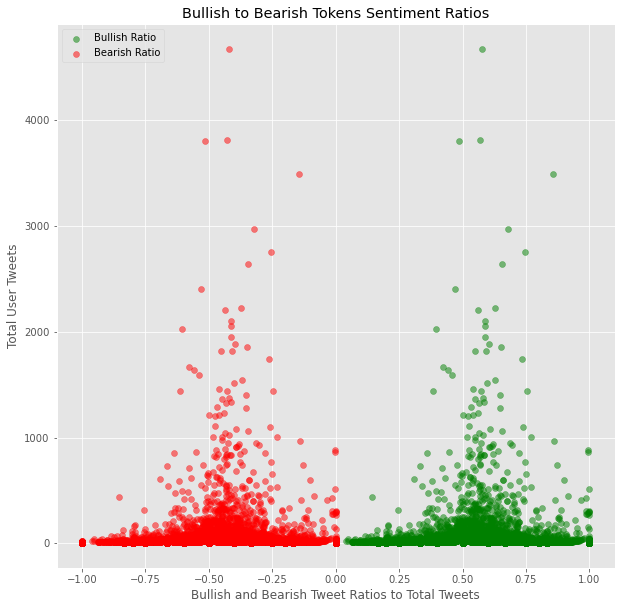

In [116]:
# Plot the Scatter Graph
x_bull = token_results['Bullish Percentages'].tolist()
x_bear = (token_results['Bearish Percentages']*-1).tolist()
y_user_tweets = token_results['Total'].tolist()

plt.figure(figsize=(10,10))

plt.title('Bullish to Bearish Tokens Sentiment Ratios')
plt.xlabel('Bullish and Bearish Tweet Ratios to Total Tweets')
plt.ylabel('Total User Tweets')

bull = plt.scatter(x_bull, y_user_tweets, alpha = 0.5, c='g')
bear = plt.scatter(x_bear, y_user_tweets, alpha = 0.5, c='r')

plt.legend((bull, bear), ('Bullish Ratio', 'Bearish Ratio'), loc='upper left', fontsize=10)

plt.show()

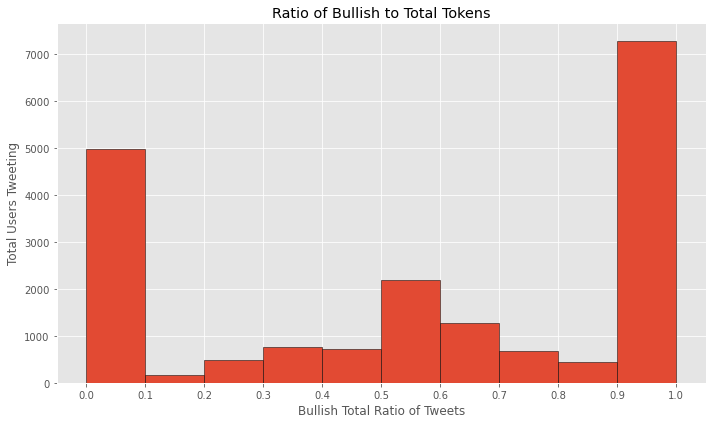

In [117]:
# Histogram for ratio's of Bullish to Total Tweets
x_ratios = token_results['Bullish Percentages'].tolist()
bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

plt.figure(figsize = (10,6))

plt.hist(x_ratios, bins = bins, edgecolor = 'black')

plt.title('Ratio of Bullish to Total Tokens')
plt.xlabel('Bullish Total Ratio of Tweets')
plt.ylabel('Total Users Tweeting')
plt.xticks(ticks = bins)

plt.tight_layout()

plt.show()

Despite their being a greater mix of words user a lot there is a higher concentration of users lent towards bullish or bearish which occures less in tweets.

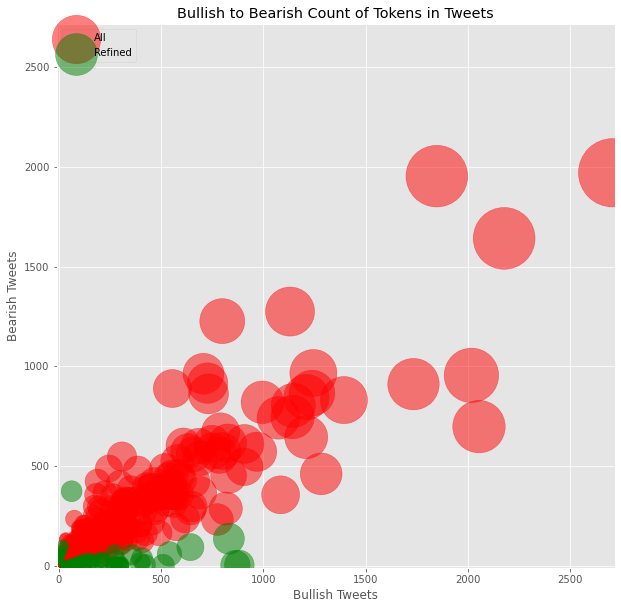

In [148]:
# Bullish to Bearish Count of Tokens in Single Tweets
x_bull = unpredictable_token['Bullish Occurences'].tolist()
y_bear = unpredictable_token['Bearish Occurences'].tolist()
s_total = unpredictable_token['Total'].tolist()

x_bull_ref = predictable_token['Bullish Occurences'].tolist()
y_bear_ref = predictable_token['Bearish Occurences'].tolist()
s_total_ref = predictable_token['Total'].tolist()

plt.figure(figsize=(10,10))

plt.scatter(x_bull, y_bear, s = s_total, alpha = 0.5, c = 'r', label = 'All')
plt.scatter(x_bull_ref, y_bear_ref, s = s_total_ref, alpha = 0.5, c = 'g', label = 'Refined')

plt.legend(loc='upper left')
plt.title('Bullish to Bearish Count of Tokens in Tweets')
plt.xlabel('Bullish Tweets')
plt.ylabel('Bearish Tweets')

# Find maximum plot value of bullish or bearish tweets
if max(x_bull) >= max(y_bear):
    plt.xlim(-10, max(x_bull) + 10)
    plt.ylim(-10, max(x_bull) + 10)
else:
    plt.xlim(-10, max(y_bear) + 10)
    plt.ylim(-10, max(y_bear) + 10)

plt.show()

The lack of area shown in this graph highlighs how tokens has a smaller chance of predicting words correctly but is better as a secondary predictor after users.

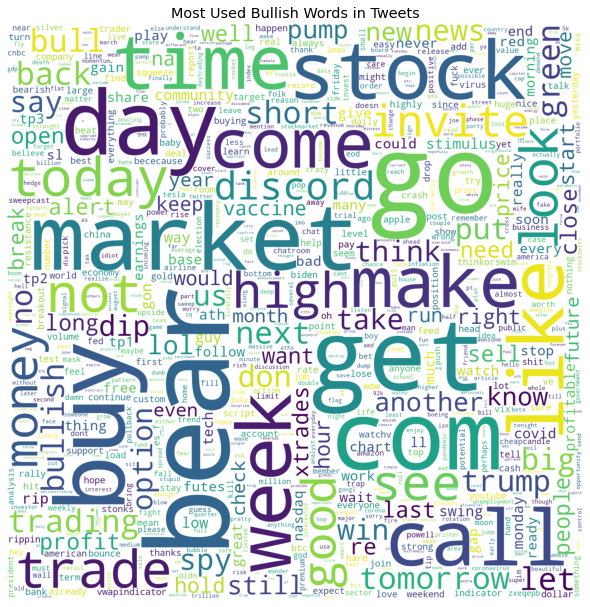

In [119]:
# Bullish Word Cloud
word_freq = token_results.set_index('Word')['Bullish Occurences'].to_dict()

wordcloud = WordCloud(width = 1500, 
                height = 1500, 
                background_color ='white',
                max_words = 800,
                max_font_size = 300, 
                min_font_size = 10).generate(str(token_results['Word'])) 

wordcloud.generate_from_frequencies(word_freq)
                      
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0)
plt.title('Most Used Bullish Words in Tweets')
  
plt.show() 

Words like Bear and bull have a greater occurence in their opposite sentimetn as they tend to talk about eachother more but most financial and political related words have no bias towards being bullish or bearish.

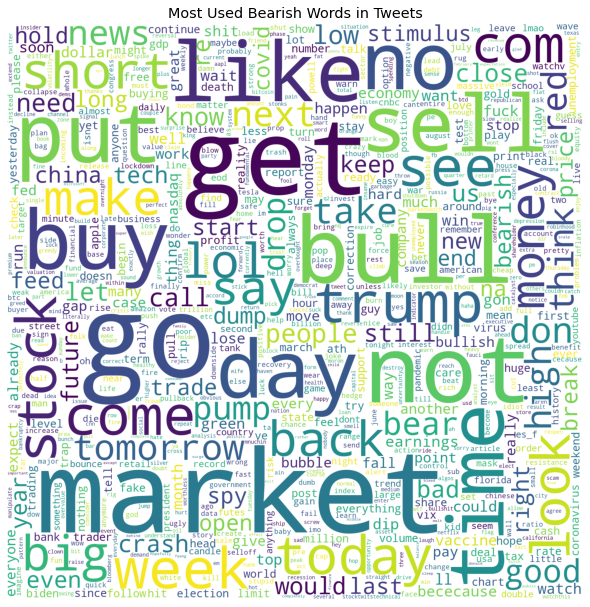

In [120]:
# Bearish Word Cloud
word_freq = token_results.set_index('Word')['Bearish Occurences'].to_dict()

wordcloud = WordCloud(width = 1500, 
                height = 1500, 
                background_color ='white',
                max_words = 800,
                max_font_size = 300, 
                min_font_size = 10).generate(str(token_results['Word'])) 

wordcloud.generate_from_frequencies(word_freq)
                      
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0)
plt.title('Most Used Bearish Words in Tweets')
  
plt.show() 

# Security Analysis and Vaidation
## Security Dataframe Processing

In [121]:
# count occurences of words of value
bullish_words = [word for tweet in bullish_data['securities'] for word in tweet.replace(",", "").replace("[", "").replace("]", "").replace("'", "").split(' ')]
bullish_word_count = Counter(bullish_words)

bearish_words = [word for tweet in bearish_data['securities'] for word in tweet.replace(",", "").replace("[", "").replace("]", "").replace("'", "").split(' ')]
bearish_word_count = Counter(bearish_words)

In [122]:
# ------------------- Convert lists into dataframes --------------------------------------
df_bullish = pd.DataFrame(bullish_word_count.items(), columns=["Security", "Bullish Occurences"])

df_bearish = pd.DataFrame(bearish_word_count.items(), columns=["Security", "Bearish Occurences"])
df_bearish.head()

,Security,Bearish Occurences
0,SPX,474
1,DJIA,473
2,DIA,308
3,QQQ,1324
4,,11923


In [123]:
# Join the tables
sec_results = df_bullish.merge(df_bearish, how= 'outer', on= 'Security')
sec_results['Bullish Occurences'].fillna(0, inplace=True)
sec_results['Bearish Occurences'].fillna(0, inplace=True)
sec_results.head()

,Security,Bullish Occurences,Bearish Occurences
0,BA,371.0,98.0
1,CCL,54.0,20.0
2,RCL,16.0,12.0
3,NCLH,74.0,15.0
4,,14932.0,11923.0


In [124]:
# Add total column (and remove $SPY as It's included in almost all tweets and skews the data)
total_column = sec_results['Bullish Occurences'] + sec_results['Bearish Occurences']
sec_results['Total'] = total_column

sec_results = sec_results[sec_results.Security != '$SPY']
sec_results = sec_results[sec_results.Security != '']
sec_results

,Security,Bullish Occurences,Bearish Occurences,Total
0,BA,371.0,98.0,469.0
1,CCL,54.0,20.0,74.0
2,RCL,16.0,12.0,28.0
3,NCLH,74.0,15.0,89.0
5,GNLN,55.0,17.0,72.0
...,...,...,...,...
1088,IWB,0.0,1.0,1.0
1089,FANG,0.0,1.0,1.0
1090,CLXT,0.0,3.0,3.0
1091,HMNY,0.0,1.0,1.0


In [125]:
# Creating Percentage Bullish to Bearish Columns
bullish_percentages = (sec_results['Bullish Occurences'] / sec_results['Total'])
bearish_percentages = (sec_results['Bearish Occurences'] / sec_results['Total'])

sec_results.insert(2, "Bullish Percentages", bullish_percentages)
sec_results.insert(4, "Bearish Percentages", bearish_percentages)

In [126]:
# Filter and Lable Security
sec_results.loc[(sec_results['Total'] < 20), 'Naive Sentiment Prediction'] = 'Unpredictable'
sec_results.loc[(sec_results['Total'] >= 20) & (sec_results['Bullish Percentages'] <= 0.8) & (sec_results['Bullish Percentages'] >= 0.2), 'Naive Sentiment Prediction'] = 'Unpredictable'

sec_results.loc[(sec_results['Total'] >= 20) & (sec_results['Bullish Percentages'] >= 0.8), 'Naive Sentiment Prediction'] = 'Bullish'
sec_results.loc[(sec_results['Total'] >= 20) & (sec_results['Bullish Percentages'] <= 0.2), 'Naive Sentiment Prediction'] = 'Bearish'
sec_results.head()

,Security,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
0,BA,371.0,0.791045,98.0,0.208955,469.0,Unpredictable
1,CCL,54.0,0.729730,20.0,0.270270,74.0,Unpredictable
2,RCL,16.0,0.571429,12.0,0.428571,28.0,Unpredictable
3,NCLH,74.0,0.831461,15.0,0.168539,89.0,Bullish
5,GNLN,55.0,0.763889,17.0,0.236111,72.0,Unpredictable


In [127]:
# Grouped Predictable Security Sentiments
grouped_predictions =  sec_results.groupby(['Naive Sentiment Prediction']).sum()
grouped_predictions = grouped_predictions.drop(columns = ['Bullish Percentages', 'Bearish Percentages'], axis = 1)
grouped_predictions

,Bullish Occurences,Bearish Occurences,Total
Naive Sentiment Prediction,,,
Bearish,9.0,62.0,71.0
Bullish,6449.0,721.0,7170.0
Unpredictable,11257.0,5329.0,16586.0


In [128]:
# Sort by total column and find top 10
sec_results = sec_results.sort_values(by='Total', ascending = False)
bar_sec_results = sec_results.head(15)

bar_sec_results

,Security,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
11,QQQ,1717.0,0.564617,1324.0,0.435383,3041.0,Unpredictable
38,AAPL,1304.0,0.770686,388.0,0.229314,1692.0,Unpredictable
15,TSLA,1204.0,0.747826,406.0,0.252174,1610.0,Unpredictable
43,AMZN,913.0,0.843029,170.0,0.156971,1083.0,Bullish
21,DJIA,456.0,0.490850,473.0,0.509150,929.0,Unpredictable
13,MSFT,669.0,0.874510,96.0,0.125490,765.0,Bullish
23,SPX,272.0,0.364611,474.0,0.635389,746.0,Unpredictable
17,DIA,389.0,0.558106,308.0,0.441894,697.0,Unpredictable
45,AMD,487.0,0.793160,127.0,0.206840,614.0,Unpredictable
0,BA,371.0,0.791045,98.0,0.208955,469.0,Unpredictable


In [129]:
#filtering tweets for 20 + tweets by User and over 80% lean towards bullish or Bearish
predictable_sec_boo = sec_results['Naive Sentiment Prediction'] != 'Unpredictable'
predictable_sec = sec_results[predictable_sec_boo]
predictable_sec.head()

,Security,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
43,AMZN,913.0,0.843029,170.0,0.156971,1083.0,Bullish
13,MSFT,669.0,0.874510,96.0,0.125490,765.0,Bullish
12,NIO,372.0,0.883610,49.0,0.116390,421.0,Bullish
142,GLD,255.0,0.817308,57.0,0.182692,312.0,Bullish
252,SLV,274.0,0.954704,13.0,0.045296,287.0,Bullish


In [130]:
#filtering tweets for 20 + tweets by User and over 80% lean towards bullish or Bearish
unpredictable_sec_boo = sec_results['Naive Sentiment Prediction'] == 'Unpredictable'
unpredictable_sec = sec_results[unpredictable_sec_boo]
unpredictable_sec.head()

,Security,Bullish Occurences,Bullish Percentages,Bearish Occurences,Bearish Percentages,Total,Naive Sentiment Prediction
11,QQQ,1717.0,0.564617,1324.0,0.435383,3041.0,Unpredictable
38,AAPL,1304.0,0.770686,388.0,0.229314,1692.0,Unpredictable
15,TSLA,1204.0,0.747826,406.0,0.252174,1610.0,Unpredictable
21,DJIA,456.0,0.490850,473.0,0.509150,929.0,Unpredictable
23,SPX,272.0,0.364611,474.0,0.635389,746.0,Unpredictable


In [131]:
# Export Table to Excel (If needed)
sec_results.to_csv(r"./securityCount.csv", index = True)

## Security Data Visulisation

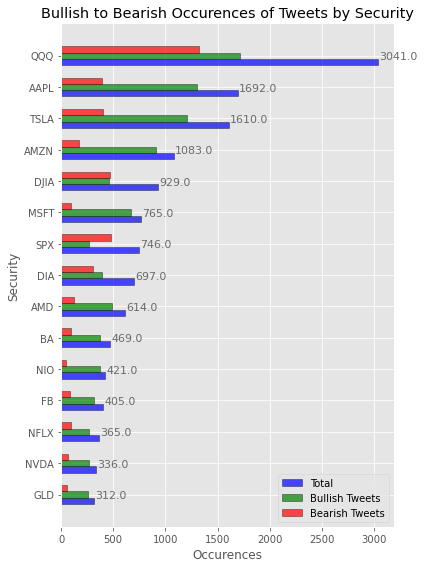

In [138]:
# Create Bar Chart of user and occurences
y_security = bar_sec_results['Security'].tolist()
y_security.reverse()

y_indexes = np.arange(len(y_security))
height = 0.2

x_bull = bar_sec_results['Bullish Occurences'].tolist()
x_bear = bar_sec_results['Bearish Occurences'].tolist()
x_total = bar_sec_results['Total'].tolist()

x_bull.reverse()
x_bear.reverse()
x_total.reverse()

plt.figure(figsize=(6,8))

multi = plt.subplot()
rects1 = multi.barh(y_indexes - height, x_total, height = height, edgecolor='black',  color = 'blue', alpha = 0.7, label = 'Total')
rects2 = multi.barh(y_indexes, x_bull, height = height, edgecolor='black', color = 'green', alpha = 0.7, label = 'Bullish Tweets')
rects3 = multi.barh(y_indexes + height, x_bear, height = height, edgecolor='black' , color = 'red', alpha = 0.7, label = 'Bearish Tweets')

plt.xlabel('Occurences')
plt.ylabel('Security')
plt.yticks(ticks = y_indexes, labels = y_security)
plt.title('Bullish to Bearish Occurences of Tweets by Security')

# set individual bar lables using above list
for i in rects1:
    # get_width pulls left or right; get_y pushes up or down
    plt.text(i.get_width() + 10, i.get_y() + .18, \
            str(round((i.get_width()), 2)), fontsize=11, color='dimgrey')

plt.legend()
plt.tight_layout()
plt.show()

The securities seem like a better predictor of sentiments than the words but not as much as users.

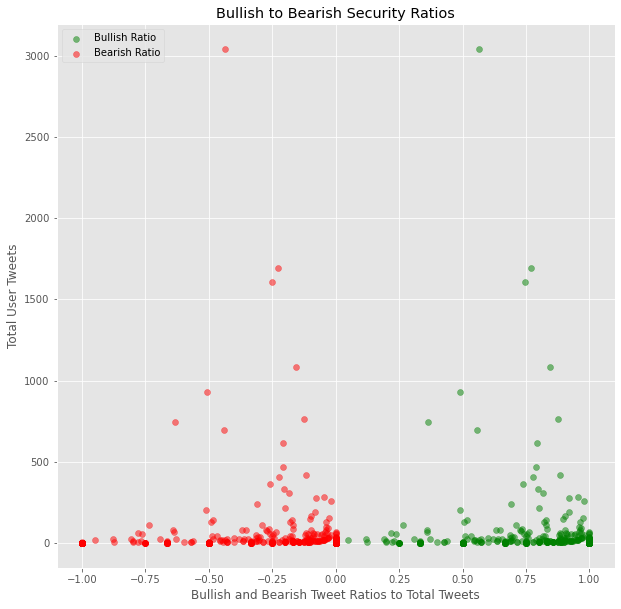

In [133]:
# Plot the Scatter Graph
x_bull = sec_results['Bullish Percentages'].tolist()
x_bear = (sec_results['Bearish Percentages']*-1).tolist()
y_user_tweets = sec_results['Total'].tolist()

plt.figure(figsize=(10,10))

plt.title('Bullish to Bearish Security Ratios')
plt.xlabel('Bullish and Bearish Tweet Ratios to Total Tweets')
plt.ylabel('Total User Tweets')

bull = plt.scatter(x_bull, y_user_tweets, alpha = 0.5, c='g')
bear = plt.scatter(x_bear, y_user_tweets, alpha = 0.5, c='r')

plt.legend((bull, bear), ('Bullish Ratio', 'Bearish Ratio'), loc='upper left', fontsize=10)

plt.show()

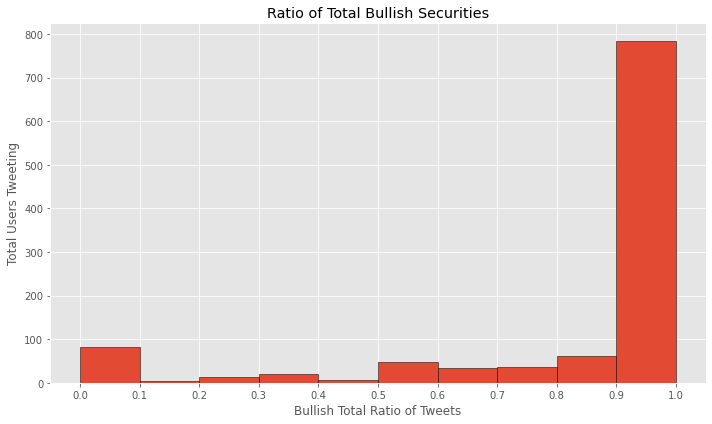

In [134]:
# Histogram for ratio's of Bullish to Total Tweets
x_ratios = sec_results['Bullish Percentages'].tolist()
bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

plt.figure(figsize = (10,6))

plt.hist(x_ratios, bins = bins, edgecolor = 'black')

plt.title('Ratio of Total Bullish Securities')
plt.xlabel('Bullish Total Ratio of Tweets')
plt.ylabel('Total Users Tweeting')
plt.xticks(ticks = bins)

plt.tight_layout()

plt.show()

Securities tend to have a much stronger correlation to just predicting Bullish tweets compared to bearish tweets with most securities being labelled as bullish_data

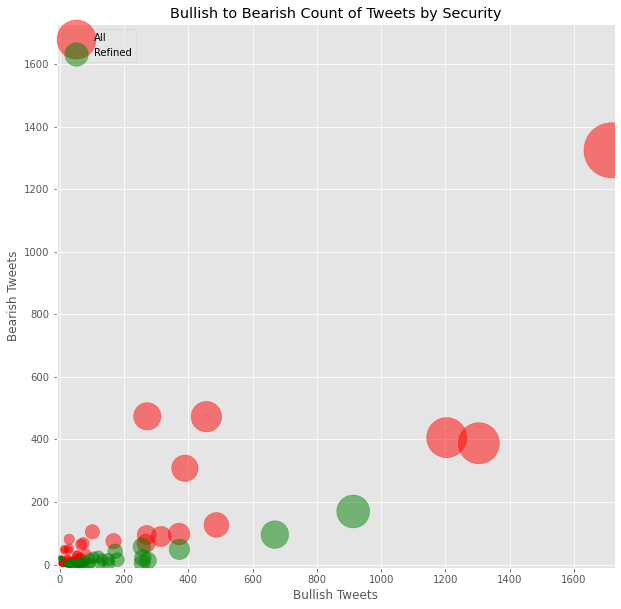

In [147]:
# Bullish to Bearish Tweets by Security
results_fil = sec_results.sort_values(by='Total', ascending= True)

x_bull = unpredictable_sec['Bullish Occurences'].tolist()
y_bear = unpredictable_sec['Bearish Occurences'].tolist()
s_total = unpredictable_sec['Total'].tolist()

x_bull_ref = predictable_sec['Bullish Occurences'].tolist()
y_bear_ref = predictable_sec['Bearish Occurences'].tolist()
s_total_ref = predictable_sec['Total'].tolist()

plt.figure(figsize=(10,10))

plt.scatter(x_bull, y_bear, s = s_total, alpha = 0.5, c = 'r', label = 'All')
plt.scatter(x_bull_ref, y_bear_ref, s = s_total_ref, alpha = 0.5, c = 'g', label = 'Refined')

plt.legend(loc='upper left', fancybox = True)
plt.title('Bullish to Bearish Count of Tweets by Security')
plt.xlabel('Bullish Tweets')
plt.ylabel('Bearish Tweets')

# Find maximum plot value of bullish or bearish tweets
if max(x_bull) >= max(y_bear):
    plt.xlim(-10, max(x_bull) + 10)
    plt.ylim(-10, max(x_bull) + 10)
else:
    plt.xlim(-10, max(y_bear) + 10)
    plt.ylim(-10, max(y_bear) + 10)

plt.show()

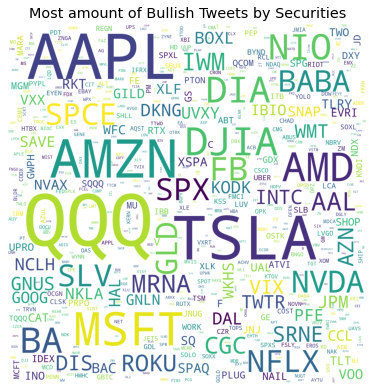

In [144]:
# Bullish Security Word Cloud
word_freq = sec_results.set_index('Security')['Bullish Occurences'].to_dict()

wordcloud = WordCloud(width = 1500, 
                height = 1500, 
                background_color ='white',
                max_words = 800,
                max_font_size = 300, 
                min_font_size = 10).generate(str(sec_results['Security'])) 

wordcloud.generate_from_frequencies(word_freq)
                      
plt.figure(figsize = (5, 5), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0)
plt.title('Most amount of Bullish Tweets by Securities')
  
plt.show() 

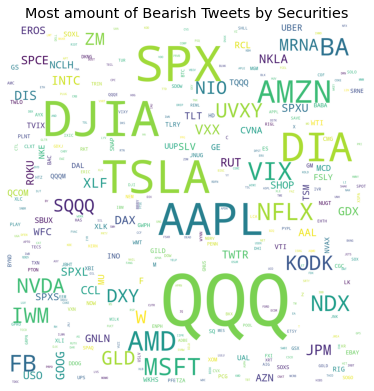

In [145]:
# Bearish Security Word Cloud
word_freq = sec_results.set_index('Security')['Bearish Occurences'].to_dict()

wordcloud = WordCloud(width = 1500, 
                height = 1500, 
                background_color ='white',
                max_words = 800,
                max_font_size = 300, 
                min_font_size = 10).generate(str(sec_results['Security'])) 

wordcloud.generate_from_frequencies(word_freq)
                      
plt.figure(figsize = (5, 5), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0)
plt.title('Most amount of Bearish Tweets by Securities')
  
plt.show() 